# Project: Wrangling and Analyze Data

## Data Gathering
In the cell below, gather **all** three pieces of data for this project and load them in the notebook. **Note:** the methods required to gather each data are different.
1. Directly download the WeRateDogs Twitter archive data (twitter_archive_enhanced.csv)

In [59]:
import pandas as pd
import numpy as np
import requests
import tweepy
import os
import json


In [60]:
print(tweepy.__version__)

4.10.0


In [61]:
#Directly download the WeRateDogs Twitter archive data (twitter_archive_enhanced.csv)
dogs_archive =  pd.read_csv('twitter-archive-enhanced.csv')

2. Use the Requests library to download the tweet image prediction (image_predictions.tsv)

In [5]:
url =  'https://d17h27t6h515a5.cloudfront.net/topher/2017/August/599fd2ad_image-predictions/image-predictions.tsv'

r = requests.get(url)

with open('image_predictions.tsv', 'wb') as f:
    f.write(r.content)

In [62]:
image_predictions = pd.read_csv('image_predictions.tsv', delimiter='\t')

3. Use the Tweepy library to query additional data via the Twitter API (tweet_json.txt)

In [ ]:
consumer_key = 'CONSUMER KEY'
consumer_secret = 'CONSUMER SECRET'
access_token = 'ACCESS TOKEN'
access_secret = 'ACCESS SECRET'

auth = tweepy.OAuthHandler(consumer_key, consumer_secret)
auth.set_access_token(access_token, access_secret)

api = tweepy.API(auth, wait_on_rate_limit=True, 
                 parser=tweepy.parsers.JSONParser())

tweet_errors = {}
tweets = dogs_archive['tweet_id']
start = time.time()
for tweet_id in tweets:
    try:
        tweet = api.get_status(tweet_id, tweet_mode='extended')
        with open('tweet_json.txt', 'a') as f:
            f.write(json.dumps(tweet) + '\n')
        print(tweet_id)
    except tweepy.TweepyException as e:
        print(f'error with{tweet_id}')
        tweet_errors[tweet_id] = e 
end = time.time()

In [63]:
data = []
with open('tweet_json.txt') as f:    
        for line in f:         
             data.append(json.loads(line))
#create dataframe from json data
twitter_df = pd.DataFrame(data)

twitter_df = twitter_df[['id', 'id_str', 'retweet_count', 'favorite_count']]


## Assessing Data
In this section, detect and document at least **eight (8) quality issues and two (2) tidiness issue**. You must use **both** visual assessment
programmatic assessement to assess the data.

**Note:** pay attention to the following key points when you access the data.

* You only want original ratings (no retweets) that have images. Though there are 5000+ tweets in the dataset, not all are dog ratings and some are retweets.
* Assessing and cleaning the entire dataset completely would require a lot of time, and is not necessary to practice and demonstrate your skills in data wrangling. Therefore, the requirements of this project are only to assess and clean at least 8 quality issues and at least 2 tidiness issues in this dataset.
* The fact that the rating numerators are greater than the denominators does not need to be cleaned. This [unique rating system](http://knowyourmeme.com/memes/theyre-good-dogs-brent) is a big part of the popularity of WeRateDogs.
* You do not need to gather the tweets beyond August 1st, 2017. You can, but note that you won't be able to gather the image predictions for these tweets since you don't have access to the algorithm used.



### **VISUAL ASSESSMENT**

In [64]:
#Display all the rows and the all text in the columns
pd.set_option('display.max_colwidth', 1000)
pd.set_option('display.max_rows', None)
pd.options.display.float_format = '{:.3f}'.format

**_dogs_archive_**

In [65]:
#Assessing the dogs_archive dataframe
dogs_archive

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,retweeted_status_id,retweeted_status_user_id,retweeted_status_timestamp,expanded_urls,rating_numerator,rating_denominator,name,doggo,floofer,pupper,puppo
0,892420643555336193,NaN,NaN,2017-08-01 16:23:56 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",This is Phineas. He's a mystical boy. Only ever appears in the hole of a donut. 13/10 https://t.co/MgUWQ76dJU,NaN,NaN,NaN,https://twitter.com/dog_rates/status/892420643555336193/photo/1,13,10,Phineas,None,None,None,None
1,892177421306343426,NaN,NaN,2017-08-01 00:17:27 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>","This is Tilly. She's just checking pup on you. Hopes you're doing ok. If not, she's available for pats, snugs, boops, the whole bit. 13/10 https://t.co/0Xxu71qeIV",NaN,NaN,NaN,https://twitter.com/dog_rates/status/892177421306343426/photo/1,13,10,Tilly,None,None,None,None
2,891815181378084864,NaN,NaN,2017-07-31 00:18:03 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",This is Archie. He is a rare Norwegian Pouncing Corgo. Lives in the tall grass. You never know when one may strike. 12/10 https://t.co/wUnZnhtVJB,NaN,NaN,NaN,https://twitter.com/dog_rates/status/891815181378084864/photo/1,12,10,Archie,None,None,None,None
3,891689557279858688,NaN,NaN,2017-07-30 15:58:51 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",This is Darla. She commenced a snooze mid meal. 13/10 happens to the best of us https://t.co/tD36da7qLQ,NaN,NaN,NaN,https://twitter.com/dog_rates/status/891689557279858688/photo/1,13,10,Darla,None,None,None,None
4,891327558926688256,NaN,NaN,2017-07-29 16:00:24 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>","This is Franklin. He would like you to stop calling him ""cute."" He is a very fierce shark and should be respected as such. 12/10 #BarkWeek https://t.co/AtUZn91f7f",NaN,NaN,NaN,"https://twitter.com/dog_rates/status/891327558926688256/photo/1,https://twitter.com/dog_rates/status/891327558926688256/photo/1",12,10,Franklin,None,None,None,None
5,891087950875897856,NaN,NaN,2017-07-29 00:08:17 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",Here we have a majestic great white breaching off South Africa's coast. Absolutely h*ckin breathtaking. 13/10 (IG: tucker_marlo) #BarkWeek https://t.co/kQ04fDDRmh,NaN,NaN,NaN,https://twitter.com/dog_rates/status/891087950875897856/photo/1,13,10,None,None,None,None,None
6,890971913173991426,NaN,NaN,2017-07-28 16:27:12 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",Meet Jax. He enjoys ice cream so much he gets nervous around it. 13/10 help Jax enjoy more things by clicking below\n\nhttps://t.co/Zr4hWfAs1H https://t.co/tVJBRMnhxl,NaN,NaN,NaN,"https://gofundme.com/ydvmve-surgery-for-jax,https://twitter.com/dog_rates/status/890971913173991426/photo/1",13,10,Jax,None,None,None,None
7,890729181411237888,NaN,NaN,2017-07-28 00:22:40 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",When you watch your owner call another dog a good boy but then they turn back to you and say you're a great boy. 13/10 https://t.co/v0nONBcwxq,NaN,NaN,NaN,"https://twitter.com/dog_rates/status/890729181411237888/photo/1,https://twitter.com/dog_rates/status/890729181411237888/photo/1",13,10,None,None,None,None,None
8,890609185150312448,NaN,NaN,2017-07-27 16:25:51 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",This is Zoey. She doesn't want to be one of the scary sharks. Just wants to be a snuggly pettable boatpet. 13/10 #BarkWeek https://t.co/9TwLuAGH0b,NaN,NaN,NaN,https://twitter.com/dog_rates/status/890609185150312448/photo/1,13,10,Zoey,None,None,None,None
9,89024025534

Issues noticed through visual assessment:
- Some dogs name are just a letter ('a') or a random word, like 'such' or 'quite'.
- Some denominator are larger or smaller than 10.
- Since we only want original ratings with images (no retweets), the columns retweeted_status_id, retweeted_status_user_id, retweeted_status_timestamp can be dropped from the dataset.
- The columns in_reply_to_status_id, in_reply_to_user_id do not provide useful information for our analysis and can be dropped.

Image_predictions: A table classifying each breed of dogs for each dogs_archive tweet.

tweet_id is the last part of the tweet URL after "status/" → https://twitter.com/dog_rates/status/889531135344209921

- p1 is the algorithm's #1 prediction for the image in the tweet → golden retriever
- p1_conf is how confident the algorithm is in its #1 prediction → 95%
- p1_dog is whether or not the #1 prediction is a breed of dog → TRUE
- p2 is the algorithm's second most likely prediction → Labrador retriever
- p2_conf is how confident the algorithm is in its #2 prediction → 1%
- p2_dog is whether or not the #2 prediction is a breed of dog → TRUE
etc.

In [66]:
#visual assessment of the image_predictions dataframe
image_predictions

,tweet_id,jpg_url,img_num,p1,p1_conf,p1_dog,p2,p2_conf,p2_dog,p3,p3_conf,p3_dog
0,666020888022790149,https://pbs.twimg.com/media/CT4udn0WwAA0aMy.jpg,1,Welsh_springer_spaniel,0.465,True,collie,0.157,True,Shetland_sheepdog,0.061,True
1,666029285002620928,https://pbs.twimg.com/media/CT42GRgUYAA5iDo.jpg,1,redbone,0.507,True,miniature_pinscher,0.074,True,Rhodesian_ridgeback,0.072,True
2,666033412701032449,https://pbs.twimg.com/media/CT4521TWwAEvMyu.jpg,1,German_shepherd,0.596,True,malinois,0.139,True,bloodhound,0.116,True
3,666044226329800704,https://pbs.twimg.com/media/CT5Dr8HUEAA-lEu.jpg,1,Rhodesian_ridgeback,0.408,True,redbone,0.361,True,miniature_pinscher,0.223,True
4,666049248165822465,https://pbs.twimg.com/media/CT5IQmsXIAAKY4A.jpg,1,miniature_pinscher,0.560,True,Rottweiler,0.244,True,Doberman,0.155,True
5,666050758794694657,https://pbs.twimg.com/media/CT5Jof1WUAEuVxN.jpg,1,Bernese_mountain_dog,0.651,True,English_springer,0.264,True,Greater_Swiss_Mountain_dog,0.016,True
6,666051853826850816,https://pbs.twimg.com/media/CT5KoJ1WoAAJash.jpg,1,box_turtle,0.933,False,mud_turtle,0.046,False,terrapin,0.018,False
7,666055525042405380,https://pbs.twimg.com/media/CT5N9tpXIAAifs1.jpg,1,chow,0.693,True,Tibetan_mastiff,0.058,True,fur_coat,0.054,False
8,666057090499244032,https://pbs.twimg.com/media/CT5PY90WoAAQGLo.jpg,1,shopping_cart,0.962,False,shopping_basket,0.015,False,golden_retriever,0.008,True
9,666058600524156928,https://pbs.twimg.com/media/CT5Qw94XAAA_2dP.jpg,1,miniature_poodle,0.201,True,komondor,0.192,True,soft-coated_wheaten_terrier,0.082,True


Issues noted through visual assessment:
- Lack of consistency: sometimes the words are lowercase, sometimes capitalized, sometimes a dash is used '-', sometimes an underscore '_'
- Some images are not of dogs (vacuum, ox, goose for example).
- We have three different predictions on the dog breed with a confidence level for each. For our analysis, we need one dog breed. To get this, we need to keep the dog breed with the highest confidence level on each row, and drop the rest. 

Twitter_df: The retweet count and favorite count for each tweet. 

In [67]:
#visual assesment of the twitter_df dataframe
twitter_df

,id,id_str,retweet_count,favorite_count
0,666020888022790149,666020888022790149,422,2289
1,892420643555336193,892420643555336193,6991,33776
2,892177421306343426,892177421306343426,5293,29282
3,891815181378084864,891815181378084864,3471,22030
4,891689557279858688,891689557279858688,7216,36891
5,891327558926688256,891327558926688256,7743,35273
6,891087950875897856,891087950875897856,2595,17787
7,890971913173991426,890971913173991426,1656,10349
8,890729181411237888,890729181411237888,15729,56795
9,890609185150312448,890609185150312448,3613,24493


- Two columns recording the tweet id. 

### **PROGRAMMATIC ASSESSMENT**

**_dogs_archive_**

In [68]:
#Print the first 5 rows of the the dogs_archive dataframe
dogs_archive.head()

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,retweeted_status_id,retweeted_status_user_id,retweeted_status_timestamp,expanded_urls,rating_numerator,rating_denominator,name,doggo,floofer,pupper,puppo
0,892420643555336193,NaN,NaN,2017-08-01 16:23:56 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",This is Phineas. He's a mystical boy. Only ever appears in the hole of a donut. 13/10 https://t.co/MgUWQ76dJU,NaN,NaN,NaN,https://twitter.com/dog_rates/status/892420643555336193/photo/1,13,10,Phineas,None,None,None,None
1,892177421306343426,NaN,NaN,2017-08-01 00:17:27 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>","This is Tilly. She's just checking pup on you. Hopes you're doing ok. If not, she's available for pats, snugs, boops, the whole bit. 13/10 https://t.co/0Xxu71qeIV",NaN,NaN,NaN,https://twitter.com/dog_rates/status/892177421306343426/photo/1,13,10,Tilly,None,None,None,None
2,891815181378084864,NaN,NaN,2017-07-31 00:18:03 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",This is Archie. He is a rare Norwegian Pouncing Corgo. Lives in the tall grass. You never know when one may strike. 12/10 https://t.co/wUnZnhtVJB,NaN,NaN,NaN,https://twitter.com/dog_rates/status/891815181378084864/photo/1,12,10,Archie,None,None,None,None
3,891689557279858688,NaN,NaN,2017-07-30 15:58:51 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",This is Darla. She commenced a snooze mid meal. 13/10 happens to the best of us https://t.co/tD36da7qLQ,NaN,NaN,NaN,https://twitter.com/dog_rates/status/891689557279858688/photo/1,13,10,Darla,None,None,None,None
4,891327558926688256,NaN,NaN,2017-07-29 16:00:24 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>","This is Franklin. He would like you to stop calling him ""cute."" He is a very fierce shark and should be respected as such. 12/10 #BarkWeek https://t.co/AtUZn91f7f",NaN,NaN,NaN,"https://twitter.com/dog_rates/status/891327558926688256/photo/1,https://twitter.com/dog_rates/status/891327558926688256/photo/1",12,10,Franklin,None,None,None,None


In [69]:
#Print a summery of the datadrame
dogs_archive.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2356 entries, 0 to 2355
Data columns (total 17 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   tweet_id                    2356 non-null   int64  
 1   in_reply_to_status_id       78 non-null     float64
 2   in_reply_to_user_id         78 non-null     float64
 3   timestamp                   2356 non-null   object 
 4   source                      2356 non-null   object 
 5   text                        2356 non-null   object 
 6   retweeted_status_id         181 non-null    float64
 7   retweeted_status_user_id    181 non-null    float64
 8   retweeted_status_timestamp  181 non-null    object 
 9   expanded_urls               2297 non-null   object 
 10  rating_numerator            2356 non-null   int64  
 11  rating_denominator          2356 non-null   int64  
 12  name                        2356 non-null   object 
 13  doggo                       2356 


- Tweet id should be a string and not an int
- Timestamp should be a datetime and should be divided in two columns, one for the date and one for the time.
- 'doggo', 'floofer', 'pupper' and 'puppo' should be in one column instead of 4, and should be of a categorical type.

In [70]:
#Pring the number of duplicated rows
dogs_archive.duplicated().sum()

0

No duplicate

In [71]:
#Finding out if there is denominator smaller or larger than 10
len(dogs_archive.query("rating_denominator != 10"))

23

- 23 rows with denominator other than 10.

In [72]:
#Print the text and rating numerator columns for all denominator other than 10
dogs_archive.query('rating_denominator != 10')[['text', 'rating_numerator', 'rating_denominator']]

,text,rating_numerator,rating_denominator
313,"@jonnysun @Lin_Manuel ok jomny I know you're excited but 960/00 isn't a valid rating, 13/10 is tho",960,0
342,@docmisterio account started on 11/15/15,11,15
433,The floofs have been released I repeat the floofs have been released. 84/70 https://t.co/NIYC820tmd,84,70
516,Meet Sam. She smiles 24/7 &amp; secretly aspires to be a reindeer. \nKeep Sam smiling by clicking and sharing this link:\nhttps://t.co/98tB8y7y7t https://t.co/LouL5vdvxx,24,7
784,"RT @dog_rates: After so many requests, this is Bretagne. She was the last surviving 9/11 search dog, and our second ever 14/10. RIP https:/…",9,11
902,Why does this never happen at my front door... 165/150 https://t.co/HmwrdfEfUE,165,150
1068,"After so many requests, this is Bretagne. She was the last surviving 9/11 search dog, and our second ever 14/10. RIP https://t.co/XAVDNDaVgQ",9,11
1120,Say hello to this unbelievably well behaved squad of doggos. 204/170 would try to pet all at once https://t.co/yGQI3He3xv,204,170
1165,Happy 4/20 from the squad! 13/10 for all https://t.co/eV1diwds8a,4,20
1202,This is Bluebert. He just saw that both #FinalFur match ups are split 50/50. Amazed af. 11/10 https://t.co/Kky1DPG4iq,50,50


- Some denominator aren't read properly. If there is another number before the rating, the number is being read instead. For example: "Happy 4/20 from the squad! 13/10 for all". Instead of 10 being the denominator, it's 20 from 4/20.
- Some numerator also aren't read properly.
- We also have some ratings that pertain to a group of dogs instead of just one, and in this case, they multiply the denominator. Example: "Here we have an entire platoon of puppers. Total score: 88/80 would pet all at once", the picture depicts more than one dog. 

In [73]:
#Print the text column for all denominator other than 10
for text in dogs_archive.query('rating_denominator != 10')['text']:
    print(text)

@jonnysun @Lin_Manuel ok jomny I know you're excited but 960/00 isn't a valid rating, 13/10 is tho
@docmisterio account started on 11/15/15
The floofs have been released I repeat the floofs have been released. 84/70 https://t.co/NIYC820tmd
Meet Sam. She smiles 24/7 &amp; secretly aspires to be a reindeer. 
Keep Sam smiling by clicking and sharing this link:
https://t.co/98tB8y7y7t https://t.co/LouL5vdvxx
RT @dog_rates: After so many requests, this is Bretagne. She was the last surviving 9/11 search dog, and our second ever 14/10. RIP https:/…
Why does this never happen at my front door... 165/150 https://t.co/HmwrdfEfUE
After so many requests, this is Bretagne. She was the last surviving 9/11 search dog, and our second ever 14/10. RIP https://t.co/XAVDNDaVgQ
Say hello to this unbelievably well behaved squad of doggos. 204/170 would try to pet all at once https://t.co/yGQI3He3xv
Happy 4/20 from the squad! 13/10 for all https://t.co/eV1diwds8a
This is Bluebert. He just saw that both #Fin

I would like to double check that all the high denominators come from pictures where more than one dog is present. 
Since one of the thing we would like to find out is what breed has the highest rating, having a rating like 121/110, even if we do decide to change the denominator into a 10 and turn it into 121/10, this will skew the average. We then have to decide if we want to fix the rating manually, or simply discard those rows.

To get all the images with more than one dog in them, we will filter the dogs_archive dataframe to keep all the rows with denominators of 50 and over, and apply the same filter to the image predictions dataframe, where the jpg link lives. We will them print the images and check how many dogs there are in each pic.

In [74]:
#Get a list of all the tweet_id for denominator equal to or larger than 50 in dogs_archive
dogs_arch_tweet_id = list(dogs_archive.query('rating_denominator >= 50')['tweet_id'])
dogs_arch_tweet_id

[820690176645140481,
 758467244762497024,
 731156023742988288,
 716439118184652801,
 713900603437621249,
 710658690886586372,
 709198395643068416,
 704054845121142784,
 684225744407494656,
 684222868335505415,
 677716515794329600,
 675853064436391936]

In [75]:
'''Create a mask with dogs_arch_tweet_id and image_predictions. 
We want to filter the image_predictions dataframe to only get the tweets with denominator other than 10, 
with the dogs_arch_tweet_id list'''

mask = image_predictions['tweet_id'].isin(dogs_arch_tweet_id)

In [76]:
#Get a list of all the tweet_id from image_prediction susing the mask
image_pred_tweet_id = list(image_predictions[mask]['tweet_id'])
image_pred_tweet_id

[675853064436391936,
 677716515794329600,
 684222868335505415,
 684225744407494656,
 704054845121142784,
 709198395643068416,
 710658690886586372,
 713900603437621249,
 716439118184652801,
 731156023742988288,
 758467244762497024,
 820690176645140481]

In [77]:
#check if both lists are identical
sorted(dogs_arch_tweet_id) == sorted(image_pred_tweet_id)

True

In [78]:
#Import libraries
from PIL import Image
from io import BytesIO
from IPython.display import display

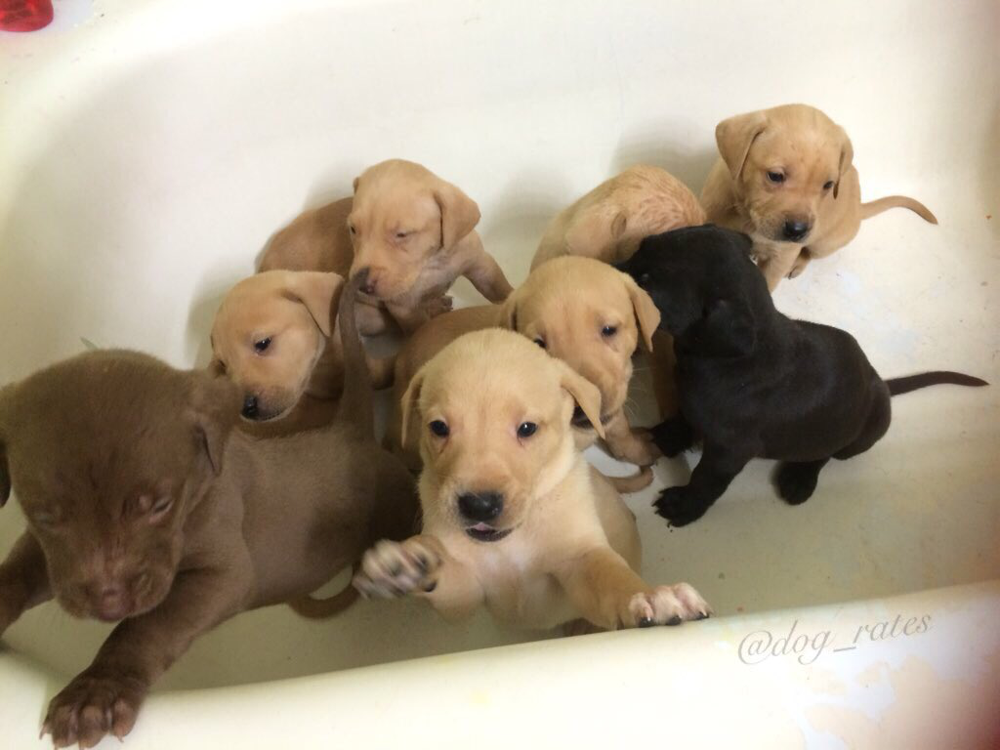

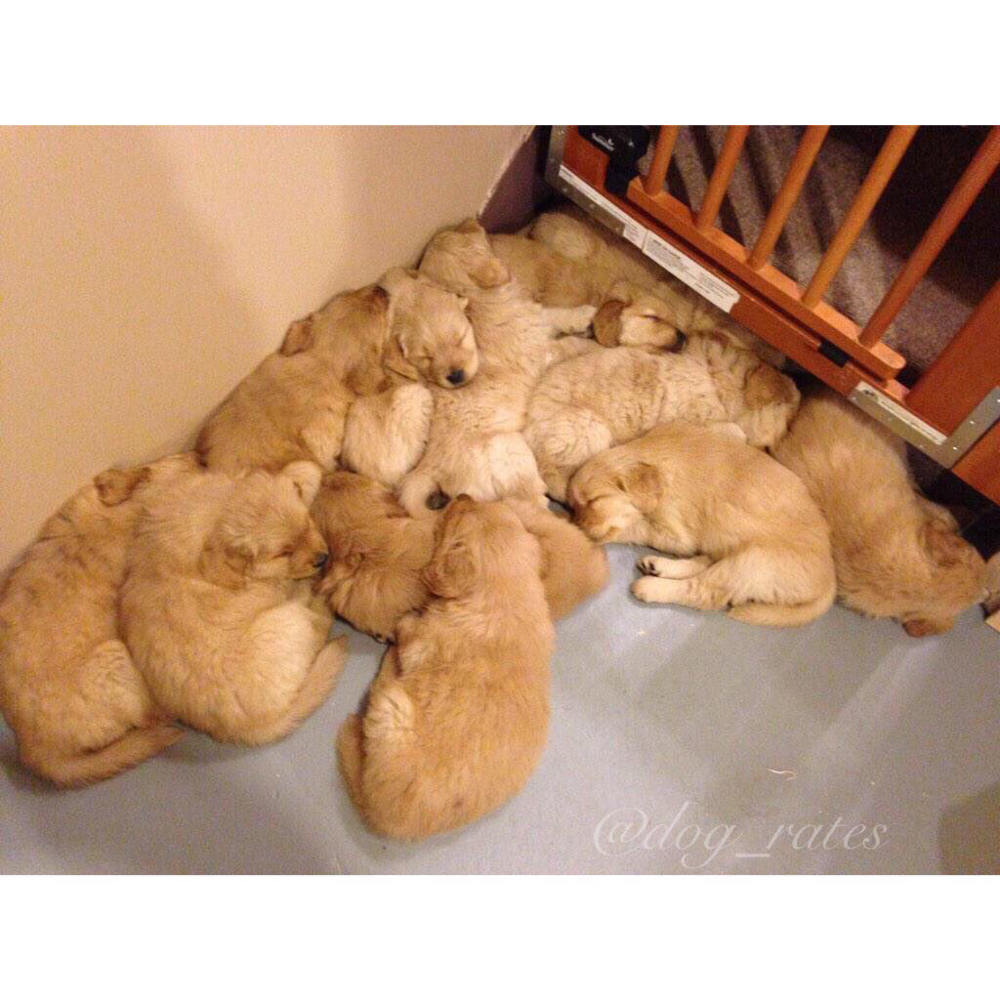

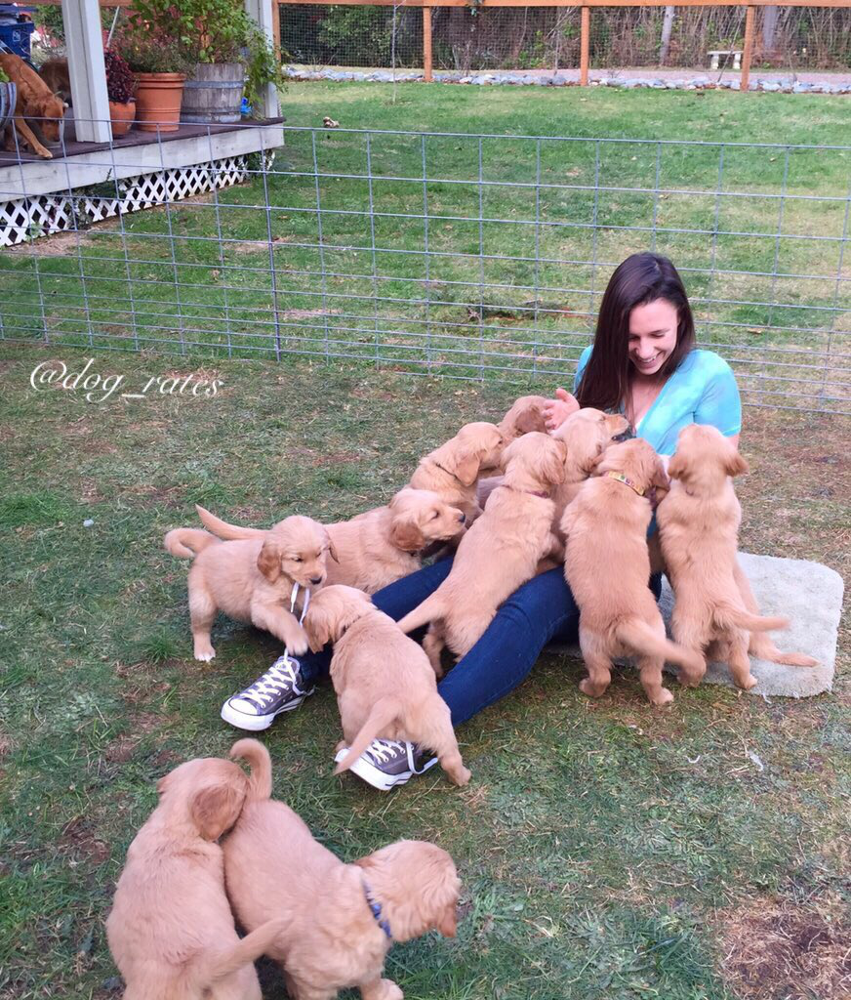

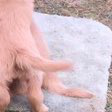

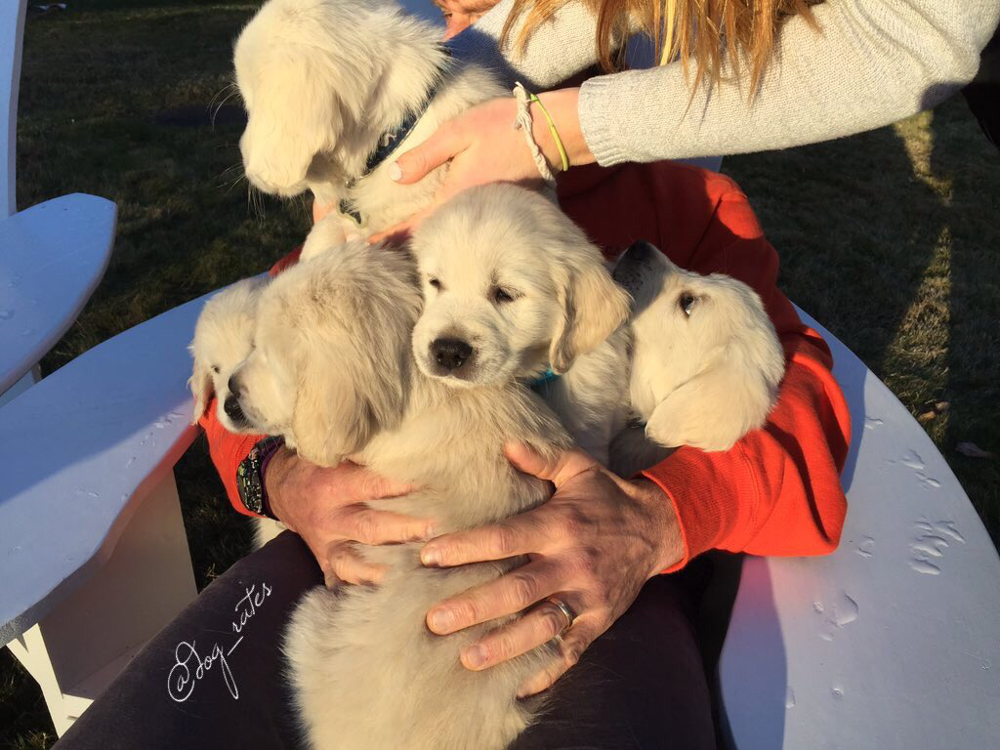

...

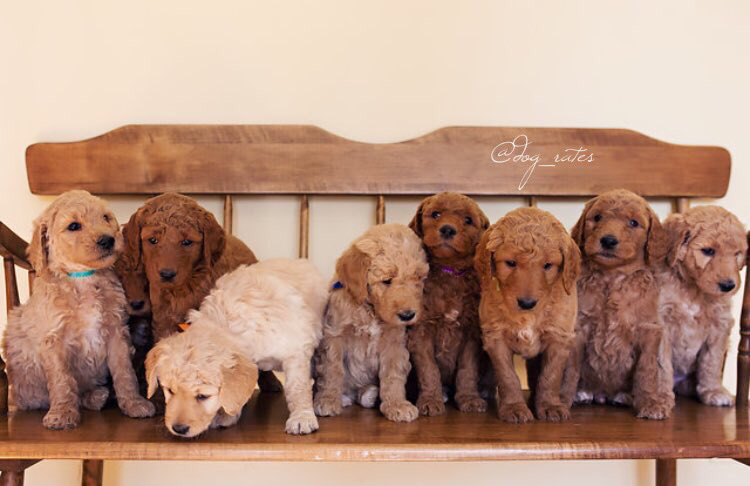

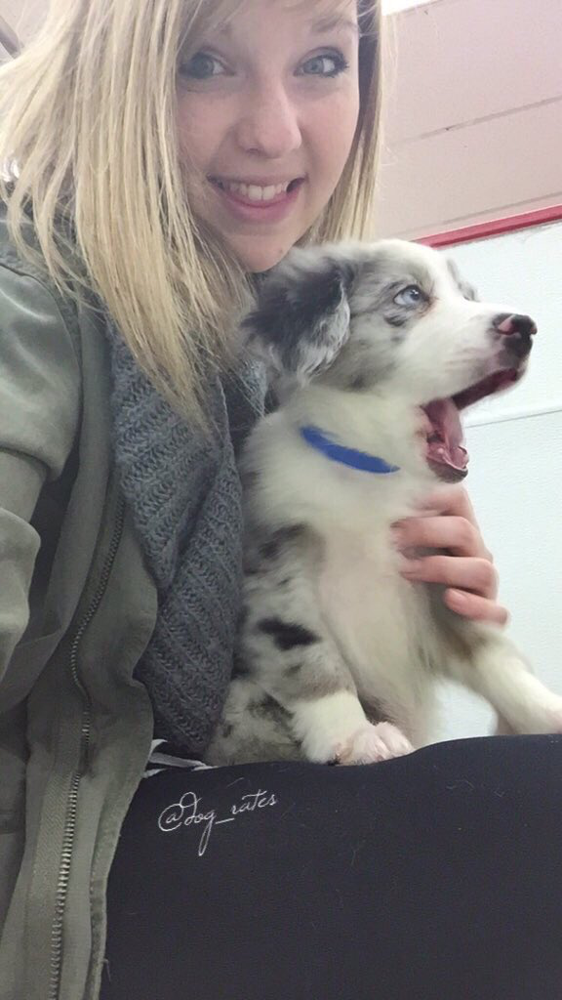

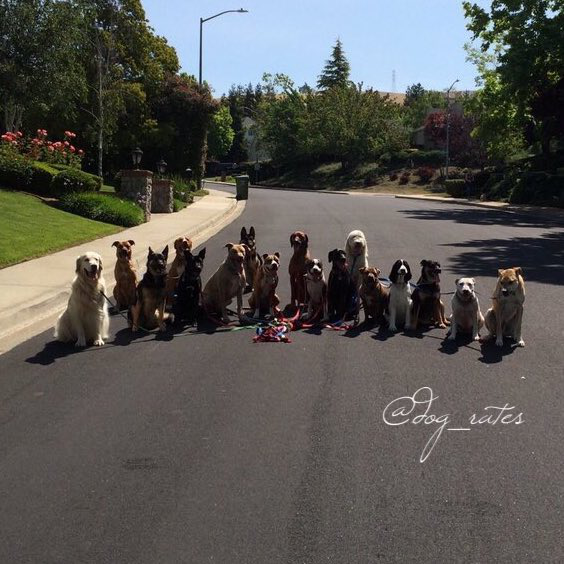

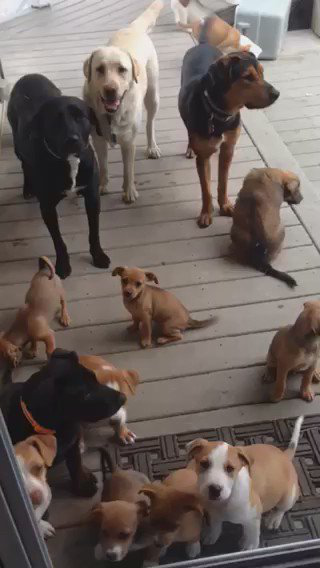

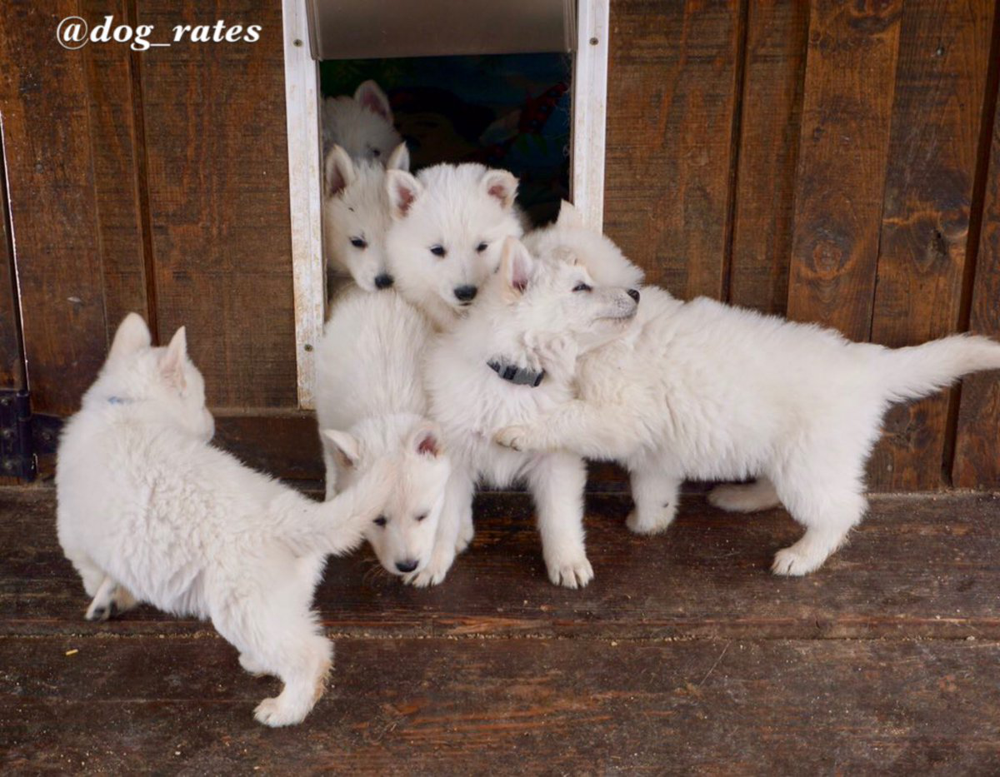

In [79]:
#Display the images for all the denominator 50 and over using a for loop
for url in image_predictions[mask]['jpg_url']:
    r_url = requests.get(url)
    image_url = Image.open(BytesIO(r_url.content))
    display(image_url)
    print()

As expected, all the images but one are of several dogs. 

In [80]:
#Check the dogs name using value_counts()
dogs_archive['name'].value_counts()

None              745
a                  55
Charlie            12
Cooper             11
Lucy               11
Oliver             11
Tucker             10
Penny              10
Lola               10
Winston             9
Bo                  9
Sadie               8
the                 8
Daisy               7
Buddy               7
Toby                7
an                  7
Bailey              7
Leo                 6
Oscar               6
Stanley             6
Rusty               6
Bella               6
Dave                6
Jack                6
Koda                6
Scout               6
Jax                 6
Milo                6
Louis               5
Phil                5
Sammy               5
Gus                 5
Chester             5
Alfie               5
Sunny               5
Bentley             5
very                5
Oakley              5
Finn                5
George              5
Larry               5
Clarence            4
Loki                4
Walter              4
Reggie    

- 'None' instead of nan values in names.
- As seen previously, we have 'a', 'the', 'quite' as dogs name. We need to replace all those values by NaN values.

Let's now look at our numerators.

In [179]:
#Print summary statistic for the rating numerator column
dogs_archive['rating_numerator'].describe()

count   2356.000
mean      13.126
std       45.877
min        0.000
25%       10.000
50%       11.000
75%       12.000
max     1776.000
Name: rating_numerator, dtype: float64

We have a large range of numbers, 0 being the minimum and 1776 the maximum. 

In [183]:
#Print the value counts 
dogs_archive['rating_numerator'].value_counts().sort_index()

0         2
1         9
2         9
3        19
4        17
5        37
6        32
7        55
8       102
9       158
10      461
11      464
12      558
13      351
14       54
15        2
17        1
20        1
24        1
26        1
27        1
44        1
45        1
50        1
60        1
75        2
80        1
84        1
88        1
99        1
121       1
143       1
144       1
165       1
182       1
204       1
420       2
666       1
960       1
1776      1
Name: rating_numerator, dtype: int64

Most of the numerators are between 3 and 14. Let's have a look at the numerator under 3.

In [188]:
dogs_archive[dogs_archive['rating_numerator'] <= 2][['text', 'rating_numerator']]

,text,rating_numerator
315,When you're so blinded by your systematic plagiarism that you forget what day it is. 0/10 https://t.co/YbEJPkg4Ag,0
605,RT @dog_rates: Not familiar with this breed. No tail (weird). Only 2 legs. Doesn't bark. Surprisingly quick. Shits eggs. 1/10 https://t.co/…,1
1016,"PUPDATE: can't see any. Even if I could, I couldn't reach them to pet. 0/10 much disappointment https://t.co/c7WXaB2nqX",0
1446,After reading the comments I may have overestimated this pup. Downgraded to a 1/10. Please forgive me,1
1761,Exotic pup here. Tail long af. Throat looks swollen. Might breathe fire. Exceptionally unfluffy 2/10 would still pet https://t.co/a8SqCaSo2r,2
1764,This is Crystal. She's a shitty fireman. No sense of urgency. People could be dying Crystal. 2/10 just irresponsible https://t.co/rtMtjSl9pz,2
1869,What kind of person sends in a picture without a dog in it? 1/10 just because that's a nice table https://t.co/RDXCfk8hK0,1
1920,This is Henry. He's a shit dog. Short pointy ears. Leaves trail of pee. Not fluffy. Doesn't come when called. 2/10 https://t.co/Pu9RhfHDEQ,2
1940,The millennials have spoken and we've decided to immediately demote to a 1/10. Thank you,1
2038,After 22 minutes of careful deliberation this dog is being demoted to a 1/10. The longer you look at him the more terrifying he becomes,1


The low ratings are genuine, only one error can be spotted at index 2335. The numerator should be a 9 instead of a 1.

In [192]:
#Print the text and the rating numerator for index 2335
dogs_archive[['text', 'rating_numerator']].loc[2335]

text                This is an Albanian 3 1/2 legged  Episcopalian. Loves well-polished hardwood flooring. Penis on the collar. 9/10 https://t.co/d9NcXFKwLv
rating_numerator                                                                                                                                           1
Name: 2335, dtype: object

Let's have a look at the numerators larger than 14.

In [195]:
dogs_archive[dogs_archive['rating_numerator'] > 14][['text', 'rating_numerator']]

,text,rating_numerator
55,@roushfenway These are good dogs but 17/10 is an emotional impulse rating. More like 13/10s,17
188,@dhmontgomery We also gave snoop dogg a 420/10 but I think that predated your research,420
189,"@s8n You tried very hard to portray this good boy as not so good, but you have ultimately failed. His goodness shines through. 666/10",666
285,RT @KibaDva: I collected all the good dogs!! 15/10 @dog_rates #GoodDogs https://t.co/6UCGFczlOI,15
290,@markhoppus 182/10,182
291,@bragg6of8 @Andy_Pace_ we are still looking for the first 15/10,15
313,"@jonnysun @Lin_Manuel ok jomny I know you're excited but 960/00 isn't a valid rating, 13/10 is tho",960
340,"RT @dog_rates: This is Logan, the Chow who lived. He solemnly swears he's up to lots of good. H*ckin magical af 9.75/10 https://t.co/yBO5wu…",75
433,The floofs have been released I repeat the floofs have been released. 84/70 https://t.co/NIYC820tmd,84
516,Meet Sam. She smiles 24/7 &amp; secretly aspires to be a reindeer. \nKeep Sam smiling by clicking and sharing this link:\nhttps://t.co/98tB8y7y7t https://t.co/LouL5vdvxx,24


The two 15 ratings are genuine. However, any ratings over 15 are either a mistake from not being read properly (due to another fraction before the rating), a rating for a group of dog instead of a single dog, or a pun (182, 420, 1776).

In [196]:
#Print the number of rows with rating over 15
len(dogs_archive[dogs_archive['rating_numerator'] > 15][['text', 'rating_numerator']])

26

Via visual assessment, we noticed that the dogs names are capitalized, and the non-capitalized words are random words that are not names. 

In [81]:
#list all names that are NOT capitalized using regex
non_dogs_name = dogs_archive['name'].str.contains('^[a-z]', regex = True)
dogs_archive[non_dogs_name]['name'].unique()

array(['such', 'a', 'quite', 'not', 'one', 'incredibly', 'mad', 'an',
       'very', 'just', 'my', 'his', 'actually', 'getting', 'this',
       'unacceptable', 'all', 'old', 'infuriating', 'the', 'by',
       'officially', 'life', 'light', 'space'], dtype=object)

This gives us a list of all the words that are not dogs names.

Looking now at the dogs category colunmns (doggo, floofer, pupper, puppo)

In [ ]:
#Create a list of all the dogs catefory for easy reference
dogs_category = ['doggo', 'floofer', 'pupper', 'puppo']

In [274]:
#Loop through the categories
for dogs in dogs_category:
    print(dogs_archive[dogs].unique())

['None' 'doggo']
['None' 'floofer']
['None' 'pupper']
['None' 'puppo']


- We also have 'None' instead of nan values.

***image_predictions***

In [83]:
#Print a summary of the dataframe
image_predictions.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2075 entries, 0 to 2074
Data columns (total 12 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   tweet_id  2075 non-null   int64  
 1   jpg_url   2075 non-null   object 
 2   img_num   2075 non-null   int64  
 3   p1        2075 non-null   object 
 4   p1_conf   2075 non-null   float64
 5   p1_dog    2075 non-null   bool   
 6   p2        2075 non-null   object 
 7   p2_conf   2075 non-null   float64
 8   p2_dog    2075 non-null   bool   
 9   p3        2075 non-null   object 
 10  p3_conf   2075 non-null   float64
 11  p3_dog    2075 non-null   bool   
dtypes: bool(3), float64(3), int64(2), object(4)
memory usage: 152.1+ KB


- Erroneous data type: tweet_id should be a string.

In [84]:
#Check for duplicate
image_predictions.duplicated().sum()

0

***twitter_df dataframe***

In [85]:
#Print a summary of the data
twitter_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2335 entries, 0 to 2334
Data columns (total 4 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   id              2335 non-null   int64 
 1   id_str          2335 non-null   object
 2   retweet_count   2335 non-null   int64 
 3   favorite_count  2335 non-null   int64 
dtypes: int64(3), object(1)
memory usage: 73.1+ KB


We have two id columns, one as int and one as string. We are interested in the string only since it is the correct datatype.

In [86]:
#Check for duplicated rows
twitter_df.duplicated().sum()

6

In [87]:
#Print the duplicated rows
twitter_df[twitter_df.duplicated(keep=False)]

,id,id_str,retweet_count,favorite_count
1,892420643555336193,892420643555336193,6991,33776
3,891815181378084864,891815181378084864,3471,22030
5,891327558926688256,891327558926688256,7743,35273
6,891087950875897856,891087950875897856,2595,17787
9,890609185150312448,890609185150312448,3613,24493
10,890240255349198849,890240255349198849,6086,27899
11,892420643555336193,892420643555336193,6991,33776
13,891815181378084864,891815181378084864,3471,22030
15,891327558926688256,891327558926688256,7743,35273
16,891087950875897856,891087950875897856,2595,17787


- Duplicated data

### Quality issues

**dogs_archive**

- Some dogs name are uncorrect, with random word like "a",
"an", "quite", "such" instead of proper name. 
- None instead of NaN in the name and dogs_category columns.
- Some denominator are smaller or larger than 10. Some are not read properly and need to be fixed manually, and some stem from a rating given to a group of dogs instead of an individual dog. 
- Some numerator are not read properly when there is another fraction in front of the rating, or if the rating is a decimal. It needs to be fixed manually.
- We are interested in original tweets only, so the columns : 'in_reply_to_status_id', 'in_reply_to_user_id','retweeted_status_id, retweeted_status_user_id, retweeted_status_timestamp' and subsequent rows, will be dropped.
-Tweet_id column should be a string, not an int.
'

**image_predictions**

- Lack of consistency, some words are lowercase, some have a dash '-' is used instead of an underscore'_'.
- tweet_id should be a string instead of an int.
- Three different predictions on the dog breed and we only want one. Keep the dog breed with the highest confidence level for each row. 

**twitter_df**

- Two columns with the same tweet id, one as an int and one as a string.
- Rename the column 'id_string' to 'tweet_id' for coherence.
- Duplicated rows.

### Tidiness issues

**dogs_archive**

- Timestamp should be a datetime object and should be divided in two columns: one for the time and one for the date.
- 'doggo', 'floofer', 'pupper' and 'puppo' should be under one column and should be of a categorical type.

**All dataframes**

- Merge the three dataframes together keeping only the columns relevant for our analysis, creating a tidy master dataframe

## Cleaning Data
In this section, clean **all** of the issues you documented while assessing. 
​
**Note:** Make a copy of the original data before cleaning. Cleaning includes merging individual pieces of data according to the rules of [tidy data](https://cran.r-project.org/web/packages/tidyr/vignettes/tidy-data.html). The result should be a high-quality and tidy master pandas DataFrame (or DataFrames, if appropriate).

In [122]:
# Make copies of original pieces of data
dogs_archive_copy = dogs_archive.copy()
image_pred_copy = image_predictions.copy()
twitter_df_copy = twitter_df.copy()

# QUALITY ISSUES

## Issue #1:

#### Define

Drop the columns, and rows if necessary, that we are not interested in keeping in the dogs_archive_copy and twitter_df_copy.

- dogs_archive_copy: 'in_reply_to_status_id', 'in_reply_to_user_id', 'retweeted_status_id', 'retweeted_status_user_id', 'retweeted_status_timestamp'.
- twitter_df_copy: id column.



Starting with the dogs_archive_copy rows that have non null values in the 'retweeted_status_id' column. This should also take care of 'retweeted_status_user_id' and 'retweeted_status_timestamp'.

#### Code

In [102]:
#Create a  list of the rows to drop by using notnull(). This will give us a list of all the rows that have a value.
rows_to_drop = list(dogs_archive_copy[dogs_archive_copy['retweeted_status_id'].notnull()].index)

In [103]:
#Drop the selected rows
dogs_archive_copy.drop(index=rows_to_drop, inplace=True)

#### Test

In [104]:
'''Print a summary of the dataframe,'retweeted_status_id', 'retweeted_status_user_id', 'retweeted_status_timestamp'
should have 0 non null values'''
dogs_archive_copy.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2175 entries, 0 to 2355
Data columns (total 17 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   tweet_id                    2175 non-null   int64  
 1   in_reply_to_status_id       78 non-null     float64
 2   in_reply_to_user_id         78 non-null     float64
 3   timestamp                   2175 non-null   object 
 4   source                      2175 non-null   object 
 5   text                        2175 non-null   object 
 6   retweeted_status_id         0 non-null      float64
 7   retweeted_status_user_id    0 non-null      float64
 8   retweeted_status_timestamp  0 non-null      object 
 9   expanded_urls               2117 non-null   object 
 10  rating_numerator            2175 non-null   int64  
 11  rating_denominator          2175 non-null   int64  
 12  name                        2175 non-null   object 
 13  doggo                       2175 

#### Define

Let's repeat the process for 'in_reply_to_user_id', that should take care of 'in_reply_to_status_id' as well.

#### Code

In [123]:
#Create a  list of the rows to drop by using notnull(). This will give us a list of all the rows that have a value.
rows_to_drop2 = list(dogs_archive_copy[dogs_archive_copy['in_reply_to_user_id'].notnull()].index)

In [126]:
#Drop the selected rows
dogs_archive_copy.drop(index=rows_to_drop2, inplace=True)

#### Test

In [127]:
#Print a summary of the dataframe, 'in_reply_to_user_id' and 'in_reply_to_status_id' should have 0 non null values
dogs_archive_copy.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2097 entries, 0 to 2355
Data columns (total 17 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   tweet_id                    2097 non-null   int64  
 1   in_reply_to_status_id       0 non-null      float64
 2   in_reply_to_user_id         0 non-null      float64
 3   timestamp                   2097 non-null   object 
 4   source                      2097 non-null   object 
 5   text                        2097 non-null   object 
 6   retweeted_status_id         0 non-null      float64
 7   retweeted_status_user_id    0 non-null      float64
 8   retweeted_status_timestamp  0 non-null      object 
 9   expanded_urls               2094 non-null   object 
 10  rating_numerator            2097 non-null   int64  
 11  rating_denominator          2097 non-null   int64  
 12  name                        2097 non-null   object 
 13  doggo                       2097 

#### Define

Drop 'retweeted_status_id', 'retweeted_status_user_id', 'retweeted_status_timestamp','in_reply_to_user_id' and 'in_reply_to_status_id' columns in dogs_archive_copy and 'id' in twitter_df_copy.

#### Code

In [128]:
# drop the columns mentioned above in dogs_archive_copy, using the drop method.
dogs_archive_copy.drop(columns=['retweeted_status_id', 'retweeted_status_user_id', 
                                'retweeted_status_timestamp','in_reply_to_user_id', 'in_reply_to_status_id'],inplace=True)

In [129]:
#drop the column 'id' in twitter_df_copy
twitter_df_copy.drop(columns='id', inplace=True)

#### Test

In [130]:
#Print the columns in dogs_archive_copy
dogs_archive_copy.columns

Index(['tweet_id', 'timestamp', 'source', 'text', 'expanded_urls',
       'rating_numerator', 'rating_denominator', 'name', 'doggo', 'floofer',
       'pupper', 'puppo'],
      dtype='object')

In [131]:
#Print the columns in twitter_df_copy
twitter_df_copy.columns

Index(['id_str', 'retweet_count', 'favorite_count'], dtype='object')

## Issue #2:

#### Define

- Replace all the names that are not actual dog names with NaN values in the dogs_archive_copy dataframe.

#### Code

In [132]:
#Dogs names are all capitalized. If the word starts with a lowercase letter, it is not a name.
#Create a list of all the unique words that start with a lowercase letter
non_dogs_name = dogs_archive_copy['name'].str.contains('^[a-z]', regex = True)
non_dogs_name = list(dogs_archive_copy[non_dogs_name]['name'].unique())

In [133]:
#Print the list
non_dogs_name

['such',
 'a',
 'quite',
 'not',
 'one',
 'incredibly',
 'very',
 'my',
 'his',
 'an',
 'actually',
 'just',
 'getting',
 'mad',
 'this',
 'unacceptable',
 'all',
 'old',
 'infuriating',
 'the',
 'by',
 'officially',
 'life',
 'light',
 'space']

In [134]:
#replace all the non-dog names with nan values
dogs_archive_copy['name'].replace(non_dogs_name, np.nan, inplace=True)

#### Test

In [135]:
# Create a for and if loop the check that we no longer have non-capitalized words.
count_not_dog_name = 0 #Create a tally, starting at 0
for dog in dogs_archive_copy['name']: #loop through each dog's name in the name column
    if type(dog) == str: #NaN type is float, so we have to add a condition
        if dog[0].islower() and dog not in not_dog_name: 
            count_not_dog_name+= 1 #if the dog's name is lower case, add 1 to the tally
    else:
        count_not_dog_name+= 0 #anything else, add nothing to the tally

count_not_dog_name #print the updated tally, should be 0

0

#### Define

Replace 'None' by nan values in the dogs_archive_copy['name'] column

#### Code

In [136]:
#Replace 'None' by np.nan()
dogs_archive_copy['name'].replace('None', np.nan, inplace=True)

#### Test

In [137]:
#Check if the string 'None' is still in the name column
len(dogs_archive_copy[dogs_archive_copy['name'].isin(['None'])])

0

### Issue #3:

#### Define
The dogs are judged out of 10. However, we have noticed previously that some denominators are smaller or larger than 10. This is caused by the rating not being read properly, or the ratings being of several dogs instead of one. In the former case, we will manually change the denominator to 10, on the latter we will drop the rows. We want all the ratings to be of individual dogs instead of a bunch, to keep it fair and not skew the average.

#### Code

In [139]:
dogs_archive_copy[dogs_archive_copy['rating_denominator'] !=10][['text','rating_denominator']]

,text,rating_denominator
433,The floofs have been released I repeat the floofs have been released. 84/70 https://t.co/NIYC820tmd,70
516,Meet Sam. She smiles 24/7 &amp; secretly aspires to be a reindeer. \nKeep Sam smiling by clicking and sharing this link:\nhttps://t.co/98tB8y7y7t https://t.co/LouL5vdvxx,7
902,Why does this never happen at my front door... 165/150 https://t.co/HmwrdfEfUE,150
1068,"After so many requests, this is Bretagne. She was the last surviving 9/11 search dog, and our second ever 14/10. RIP https://t.co/XAVDNDaVgQ",11
1120,Say hello to this unbelievably well behaved squad of doggos. 204/170 would try to pet all at once https://t.co/yGQI3He3xv,170
1165,Happy 4/20 from the squad! 13/10 for all https://t.co/eV1diwds8a,20
1202,This is Bluebert. He just saw that both #FinalFur match ups are split 50/50. Amazed af. 11/10 https://t.co/Kky1DPG4iq,50
1228,Happy Saturday here's 9 puppers on a bench. 99/90 good work everybody https://t.co/mpvaVxKmc1,90
1254,Here's a brigade of puppers. All look very prepared for whatever happens next. 80/80 https://t.co/0eb7R1Om12,80
1274,"From left to right:\nCletus, Jerome, Alejandro, Burp, &amp; Titson\nNone know where camera is. 45/50 would hug all at once https://t.co/sedre1ivTK",50


As seen previously, most of the denominators other than bigger than 10 come from ratings of a group of dogs, instead of a single dog. We will change the denominator to 10 for that rows that indeed describe a single dog, and drop all other rows. 

Let's start by changing the denominator for the row index 1202: 'This is Bluebert. He just saw that both #FinalFur match ups are split 50/50. Amazed af.'

In [143]:
#Change the denominator for row 1202 to 10 manually
dogs_archive_copy.loc[1202, 'rating_denominator'] = 10

#### Test

In [144]:
#Print the rating denomanitor for row 1202, should be 10 
dogs_archive_copy.loc[1202][['text', 'rating_denominator']]

text                  This is Bluebert. He just saw that both #FinalFur match ups are split 50/50. Amazed af. 11/10 https://t.co/Kky1DPG4iq
rating_denominator                                                                                                                       10
Name: 1202, dtype: object

#### Define

All the rating denominators equal or bigger than 40 are for pictures of more than one dog. We can drop those rows. 

#### Code

In [148]:
#Create a mask that filters all the rating_denomitor not equal to 10
mask_rating = (dogs_archive_copy['rating_denominator'] >=40)

In [149]:
#Drop the rows
dogs_archive_copy.drop(index=dogs_archive_copy[mask_rating].index, inplace=True)

#### Test

In [150]:
#Print all the rows with rating denominator other than 10
dogs_archive_copy[dogs_archive_copy['rating_denominator'] !=10][['text','rating_denominator']]

,text,rating_denominator
516,Meet Sam. She smiles 24/7 &amp; secretly aspires to be a reindeer. \nKeep Sam smiling by clicking and sharing this link:\nhttps://t.co/98tB8y7y7t https://t.co/LouL5vdvxx,7
1068,"After so many requests, this is Bretagne. She was the last surviving 9/11 search dog, and our second ever 14/10. RIP https://t.co/XAVDNDaVgQ",11
1165,Happy 4/20 from the squad! 13/10 for all https://t.co/eV1diwds8a,20
1662,This is Darrel. He just robbed a 7/11 and is in a high speed police chase. Was just spotted by the helicopter 10/10 https://t.co/7EsP8LmSp5,11
2335,This is an Albanian 3 1/2 legged Episcopalian. Loves well-polished hardwood flooring. Penis on the collar. 9/10 https://t.co/d9NcXFKwLv,2


All the rows pertaining to group of dogs have been dropped. We can change the other denominator manually, but first we need to drop the row index 516 since it is not a rating.

#### Define

Drop row index 516, and change all the other rating_denominator so they all are 10.

#### Code

In [152]:
#Drop row 516
dogs_archive_copy.drop(index=516, inplace=True)

In [153]:
#Change all ther rating denominator to 10
dogs_archive_copy['rating_denominator'] = 10

#### Test

In [154]:
#Check the rating denominators, should be 10s only.
dogs_archive_copy['rating_denominator'].value_counts()

10    2085
Name: rating_denominator, dtype: int64

### Issue #4:

#### Define

Drop all the rating numerator greater than 15. 

#### Code

In [201]:
#Create a list of the rows' indexes where the numerator is larger than 15
larger_than15 = list(dogs_archive_copy.query('rating_numerator > 15').index)

In [202]:
#Use drop and inplace=True to drop the rows
dogs_archive_copy.drop(index=larger_than15, inplace=True)

#### Test

In [206]:
#Print the unique values in the rating numerator column, should  be no highter than 15
dogs_archive_copy['rating_numerator'].unique()

array([13, 12, 14,  5, 11,  6, 10,  0,  3,  7,  8,  9,  4,  2,  1],
      dtype=int64)

### Issue #5:

#### Define

Replace the None values with nan values in the name column in dog_archive_copy

#### Code

In [207]:
#Replace None with np.nan
dogs_archive_copy['name'].replace('None', np.nan, inplace=True)

#### Test

In [214]:
#Count the number of 'None' instances in the name column, should be 0
(dogs_archive_copy['name'] == 'None').sum()

0

### Issue #6:

#### Define

Change the timestamp column in dogs_archive_copy into a datetime object, and split the column in two: one column for the date and one for the time.

#### Code

In [217]:
#import the datetime library
import datetime

In [218]:
#Change the timestamp type from string to datetime
dogs_archive_copy['timestamp'] = pd.to_datetime(dogs_archive_copy['timestamp'])

#### Test

In [223]:
#Check the type of timestamp using .info()
dogs_archive_copy.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2079 entries, 0 to 2355
Data columns (total 12 columns):
 #   Column              Non-Null Count  Dtype              
---  ------              --------------  -----              
 0   tweet_id            2079 non-null   int64              
 1   timestamp           2079 non-null   datetime64[ns, UTC]
 2   source              2079 non-null   object             
 3   text                2079 non-null   object             
 4   expanded_urls       2076 non-null   object             
 5   rating_numerator    2079 non-null   int64              
 6   rating_denominator  2079 non-null   int64              
 7   name                1385 non-null   object             
 8   doggo               2079 non-null   object             
 9   floofer             2079 non-null   object             
 10  pupper              2079 non-null   object             
 11  puppo               2079 non-null   object             
dtypes: datetime64[ns, UTC](1), int64(3

#### Code

In [225]:
#Split the timestamp column into two columns
dogs_archive_copy['tweet_date'] = dogs_archive_copy['timestamp'].dt.date
dogs_archive_copy['tweet_time'] = dogs_archive_copy['timestamp'].dt.time

In [227]:
#Drop the timestamp column
dogs_archive_copy.drop(columns='timestamp', inplace=True)

#### Test

In [229]:
#Print the dogs_archive_copy columns
dogs_archive_copy.columns

Index(['tweet_id', 'source', 'text', 'expanded_urls', 'rating_numerator',
       'rating_denominator', 'name', 'doggo', 'floofer', 'pupper', 'puppo',
       'tweet_date', 'tweet_time'],
      dtype='object')

In [230]:
#Print a sample of the dataframe
dogs_archive_copy.sample(3)

,tweet_id,source,text,expanded_urls,rating_numerator,rating_denominator,name,doggo,floofer,pupper,puppo,tweet_date,tweet_time
1293,708026248782585858,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",Everybody stop what you're doing and watch this video. Frank is stuck in a loop. 13/10 (Vid by @klbmatty) https://t.co/5AJs8TIV1U,https://twitter.com/dog_rates/status/708026248782585858/video/1,13,10,NaN,None,None,None,None,2016-03-10,20:26:26
2047,671518598289059840,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",This is Scruffers. He's being violated on multiple levels and is not happy about it. 9/10 hang in there Scruffers https://t.co/nLQoltwEZ7,https://twitter.com/dog_rates/status/671518598289059840/photo/1,9,10,Scruffers,None,None,None,None,2015-12-01,02:38:04
1328,705970349788291072,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",This is Lucy. She's a Venetian Kerploof. Supposed to be navigating. Quite irresponsible. Fancy ass collar tho 12/10 https://t.co/8tjnz1L8DI,https://twitter.com/dog_rates/status/705970349788291072/photo/1,12,10,Lucy,None,None,None,None,2016-03-05,04:17:02


### Issue #7:

#### Define

Change the type of tweet_id in both dogs_archive_copy and image_pred_copy, from integer to string.

#### Code

In [231]:
#Change tweet_id's type in dogs_archive_copy
dogs_archive_copy['tweet_id'] = dogs_archive_copy['tweet_id'].astype('str')

In [232]:
#Change tweet_id's type in image_pred_copy
image_pred_copy['tweet_id'] = image_pred_copy['tweet_id'].astype('str')

#### Test

In [235]:
#Check tweet_id type with .info()
dogs_archive_copy.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2079 entries, 0 to 2355
Data columns (total 13 columns):
 #   Column              Non-Null Count  Dtype 
---  ------              --------------  ----- 
 0   tweet_id            2079 non-null   object
 1   source              2079 non-null   object
 2   text                2079 non-null   object
 3   expanded_urls       2076 non-null   object
 4   rating_numerator    2079 non-null   int64 
 5   rating_denominator  2079 non-null   int64 
 6   name                1385 non-null   object
 7   doggo               2079 non-null   object
 8   floofer             2079 non-null   object
 9   pupper              2079 non-null   object
 10  puppo               2079 non-null   object
 11  tweet_date          2079 non-null   object
 12  tweet_time          2079 non-null   object
dtypes: int64(2), object(11)
memory usage: 291.9+ KB


In [234]:
#Check tweet_id type with .info()
image_pred_copy.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2075 entries, 0 to 2074
Data columns (total 12 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   tweet_id  2075 non-null   object 
 1   jpg_url   2075 non-null   object 
 2   img_num   2075 non-null   int64  
 3   p1        2075 non-null   object 
 4   p1_conf   2075 non-null   float64
 5   p1_dog    2075 non-null   bool   
 6   p2        2075 non-null   object 
 7   p2_conf   2075 non-null   float64
 8   p2_dog    2075 non-null   bool   
 9   p3        2075 non-null   object 
 10  p3_conf   2075 non-null   float64
 11  p3_dog    2075 non-null   bool   
dtypes: bool(3), float64(3), int64(1), object(5)
memory usage: 152.1+ KB


### Issue #7:

#### Define

Drop the duplicates rows in the twitter_df_copy dataframe

#### Code

In [236]:
#Check the number of rows before the drop
len(twitter_df_copy)

2335

In [237]:
#Drop the duplicated rows using drop_duplicates()
twitter_df_copy.drop_duplicates(inplace=True)

#### Test

In [238]:
#Check the number of duplicated rows
twitter_df_copy.duplicated().sum()

0

In [239]:
#Check the number of rows, should be smaller than 2335
len(twitter_df_copy)

2329

### Issue #8:

#### Define

In image_pred_copy, convert all the dog types into lowercase and replace the dashes ('-') with underscores (_).

In [243]:
#Create a function that will convert the values in a column into lowercase
def convert_to_lower(df, columns):
    for column in df[columns]:
        df[column] = df[column].str.lower()

In [246]:
#Use the function to convert p1, p2, p3 in image_pred_copy to lowercase
convert_to_lower(image_pred_copy, ['p1','p2', 'p3'])

#### Test

In [250]:
#Check if every string in p1, p2 and p3 are now lowercase, should print True.
image_pred_copy['p1'].str.islower().all(), image_pred_copy['p2'].str.islower().all(), image_pred_copy['p3'].str.islower().all()

(True, True, True)

#### Code

In [256]:
#Create a function that will change dashes into underscores
def replace_dashes(df, columns):
    for column in df[columns]:
        df[column] = df[column].str.replace('-', '_')

In [261]:
#Use the function defined above to chage all the dashes in p1, p2, p3 into underscores
replace_dashes(image_pred_copy, ['p1','p2', 'p3'])

#### Test

In [262]:
#Print the number of string containing '-' in p1, p2 and p3, should be 0
print(image_pred_copy['p1'].str.contains('-').sum())
print(image_pred_copy['p2'].str.contains('-').sum())
print(image_pred_copy['p3'].str.contains('-').sum())

0
0
0


### Issue #9:

#### Define

In image_pred_copy dataframe, the columns p1, p2 and p3 are predicting the breed in the tweet's picture. P1 being the most likely prediction, p2 the second most likely and p3 the third most likely. P1_dog, p2_dog, p3_dog are telling us whether or not the algorithm used, believe the animal in the picture is a dog or not (True or False). p1_cong, p2_conf, p3_conf is telling us the confidence level for each prediction in percentage.

We want to keep the prediction with the highest confidence level that reads TRUE. If all three predictions flag the image as FALSE (not a dog in the picture), we will register the breed as 'None'.

Once this is done, we can drop those columns to only keep tweet_id, jpg_url, img_num, breed, confidence.

#### Code

In [265]:
# setup the conditions for selection
conditions = [(image_pred_copy['p1_dog'] == True),
              (image_pred_copy['p2_dog'] == True),
              (image_pred_copy['p3_dog'] == True)]

choices_breed = [image_pred_copy['p1'], 
                 image_pred_copy['p2'],
                 image_pred_copy['p3']]

choices_confidence = [image_pred_copy['p1_conf'], 
                      image_pred_copy['p2_conf'], 
                      image_pred_copy['p3_conf']]

In [266]:
# select the predicted breed based on the first successful condition
image_pred_copy['breed'] = np.select(conditions, choices_breed, 
                                       default = 'none')

In [267]:
# select the predicted confidence level based on the first successful condition
image_pred_copy['confidence'] = np.select(conditions, choices_confidence, 
                                            default = 0)

#### Test

In [270]:
#Print a sample of the dataframe
image_pred_copy.sample(5)

,tweet_id,jpg_url,img_num,p1,p1_conf,p1_dog,p2,p2_conf,p2_dog,p3,p3_conf,p3_dog,breed,confidence
1030,711306686208872448,https://pbs.twimg.com/media/Cd8Rpl0W0AAN1kU.jpg,1,leatherback_turtle,0.281,False,loggerhead,0.123,False,dandie_dinmont,0.087,True,dandie_dinmont,0.087
811,692417313023332352,https://pbs.twimg.com/media/CZv13u5WYAA6wQe.jpg,1,bison,0.209,False,mink,0.170,False,polecat,0.144,False,none,0.000
1253,748307329658011649,https://pbs.twimg.com/media/CmKFi-FXEAAeI37.jpg,2,paddle,0.589,False,shovel,0.038,False,mountain_tent,0.029,False,none,0.000
260,670783437142401025,https://pbs.twimg.com/media/CU8Z-OxXAAA-sd2.jpg,1,lacewing,0.382,False,sulphur_butterfly,0.107,False,leafhopper,0.068,False,none,0.000
1436,773922284943896577,https://pbs.twimg.com/media/Cr2GNdlW8AAbojw.jpg,1,pomeranian,0.554,True,samoyed,0.432,True,chow,0.003,True,pomeranian,0.554


#### Code

In [272]:
#Drop all the columns, keeping only tweet_id, jpg_url, img_num, breed, confidence.
image_pred_copy.drop(columns=['p1', 'p1_conf', 'p1_dog', 'p2',
       'p2_conf', 'p2_dog', 'p3', 'p3_conf', 'p3_dog'], inplace=True)

#### Test

In [273]:
image_pred_copy.columns

Index(['tweet_id', 'jpg_url', 'img_num', 'breed', 'confidence'], dtype='object')

# TIDINESS ISSUES

### Issue #1:

#### Define

dogs_archive_clean:

- Combine the four columns that represent the dog stage into one column called 'dog_stage'
- Drop the doggo, pupper, floofer, puppo columns
- Change the dog_stage datatype to category
- Replace null-values with np.nan

In [ ]:
dogs_archive_copy

#### Code

In [277]:
#Change the None values into empty strings to facilitate the concatenation
dogs_archive_copy[['doggo','pupper', 'floofer', 'puppo']] = dogs_archive_copy[['doggo','pupper', 'floofer', 'puppo']].replace('None', '')

In [279]:
#Concatenate all the dog types in one column called 'dog_stage'. If more than one value, they are separated by a space.
dogs_archive_copy['dog_stage'] = dogs_archive_copy['doggo'].str.cat(dogs_archive_copy['pupper'], sep=' ').str.cat(dogs_archive_copy['floofer'], sep=' ').str.cat(dogs_archive_copy['puppo'], sep=' ')

In [281]:
#strip the leading and ending whitespace.
dogs_archive_copy['dog_stage'] = dogs_archive_copy['dog_stage'].str.strip()

In [284]:
#Replace ' ' with np.nan
dogs_archive_copy['dog_stage'] = dogs_archive_copy['dog_stage'].replace('', np.nan)

In [300]:
#Replace the whitespace in the middle of the words when needed with a backslash ('/')
dogs_archive_copy['dog_stage'] = dogs_archive_copy['dog_stage'].str.replace('\s+', '/', regex=True)

In [303]:
#drop the doggo, floofer, pupper and puppo columns
dogs_archive_copy.drop(columns=['doggo', 'floofer', 'pupper', 'puppo'], inplace=True)

In [305]:
#Change the dog_stage datatype to category
dogs_archive_copy['dog_stage'] = dogs_archive_copy['dog_stage'].astype('category')

#### Test

In [307]:
#Check the type of the dog_stage with info, shoudd be a category
dogs_archive_copy.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2079 entries, 0 to 2355
Data columns (total 10 columns):
 #   Column              Non-Null Count  Dtype   
---  ------              --------------  -----   
 0   tweet_id            2079 non-null   object  
 1   source              2079 non-null   object  
 2   text                2079 non-null   object  
 3   expanded_urls       2076 non-null   object  
 4   rating_numerator    2079 non-null   int64   
 5   rating_denominator  2079 non-null   int64   
 6   name                1385 non-null   object  
 7   tweet_date          2079 non-null   object  
 8   tweet_time          2079 non-null   object  
 9   dog_stage           335 non-null    category
dtypes: category(1), int64(2), object(7)
memory usage: 229.3+ KB


In [309]:
#Print the columns
dogs_archive_copy.columns

Index(['tweet_id', 'source', 'text', 'expanded_urls', 'rating_numerator',
       'rating_denominator', 'name', 'tweet_date', 'tweet_time', 'dog_stage'],
      dtype='object')

### Issue #2:

#### Define
- Merge the three dataframes to create one master dataframe.

#### Code

In [79]:
#merge the three dataframe into one master dataframe
master_df = dogs_archive_clean.merge(image_pred_clean, on='tweet_id', how='inner').merge(twitter_df_clean, on='tweet_id', how='inner')

#### Test

In [80]:
master_df.head()

,tweet_id,timestamp,text,expanded_urls,rating_numerator,rating_denominator,name,dog_stage,jpg_url,img_num,p1,p1_conf,p1_dog,retweet_count,favorite_count
0,892177421306343426,2017-08-01 00:17:27,"This is Tilly. She's just checking pup on you. Hopes you're doing ok. If not, she's available for pats, snugs, boops, the whole bit. 13/10 https://t.co/0Xxu71qeIV",https://twitter.com/dog_rates/status/892177421306343426/photo/1,13.0,10,Tilly,NaN,https://pbs.twimg.com/media/DGGmoV4XsAAUL6n.jpg,1,chihuahua,0.323581,True,5293,29282
1,892177421306343426,2017-08-01 00:17:27,"This is Tilly. She's just checking pup on you. Hopes you're doing ok. If not, she's available for pats, snugs, boops, the whole bit. 13/10 https://t.co/0Xxu71qeIV",https://twitter.com/dog_rates/status/892177421306343426/photo/1,13.0,10,Tilly,NaN,https://pbs.twimg.com/media/DGGmoV4XsAAUL6n.jpg,1,chihuahua,0.323581,True,5293,29295
2,891815181378084864,2017-07-31 00:18:03,This is Archie. He is a rare Norwegian Pouncing Corgo. Lives in the tall grass. You never know when one may strike. 12/10 https://t.co/wUnZnhtVJB,https://twitter.com/dog_rates/status/891815181378084864/photo/1,12.0,10,Archie,NaN,https://pbs.twimg.com/media/DGBdLU1WsAANxJ9.jpg,1,chihuahua,0.716012,True,3471,22030
3,891327558926688256,2017-07-29 16:00:24,"This is Franklin. He would like you to stop calling him ""cute."" He is a very fierce shark and should be respected as such. 12/10 #BarkWeek https://t.co/AtUZn91f7f","https://twitter.com/dog_rates/status/891327558926688256/photo/1,https://twitter.com/dog_rates/status/891327558926688256/photo/1",12.0,10,Franklin,NaN,https://pbs.twimg.com/media/DF6hr6BUMAAzZgT.jpg,2,basset,0.555712,True,7743,35273
4,891087950875897856,2017-07-29 00:08:17,Here we have a majestic great white breaching off South Africa's coast. Absolutely h*ckin breathtaking. 13/10 (IG: tucker_marlo) #BarkWeek https://t.co/kQ04fDDRmh,https://twitter.com/dog_rates/status/891087950875897856/photo/1,13.0,10,NaN,NaN,https://pbs.twimg.com/media/DF3HwyEWsAABqE6.jpg,1,chesapeake_bay_retriever,0.425595,True,2595,17787


In [81]:
master_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1457 entries, 0 to 1456
Data columns (total 15 columns):
tweet_id              1457 non-null object
timestamp             1457 non-null datetime64[ns]
text                  1457 non-null object
expanded_urls         1457 non-null object
rating_numerator      1457 non-null float64
rating_denominator    1457 non-null int64
name                  1037 non-null object
dog_stage             226 non-null category
jpg_url               1457 non-null object
img_num               1457 non-null int64
p1                    1457 non-null object
p1_conf               1457 non-null float64
p1_dog                1457 non-null bool
retweet_count         1457 non-null int64
favorite_count        1457 non-null int64
dtypes: bool(1), category(1), datetime64[ns](1), float64(2), int64(4), object(6)
memory usage: 162.6+ KB


In [82]:
#Check if we the columns merge properly
columns_list = pd.Series(list(dogs_archive_clean) + list(image_pred_clean) + list(twitter_df_clean))
columns_list.drop_duplicates(inplace=True)
columns_list == list(master_df)

0     True
1     True
2     True
3     True
4     True
5     True
6     True
7     True
9     True
10    True
11    True
12    True
13    True
15    True
16    True
dtype: bool

## Storing Data
Save gathered, assessed, and cleaned master dataset to a CSV file named "twitter_archive_master.csv".

In [83]:
#save the master_df to a csv file called 'twitter_archive_master'
master_df.to_csv('twitter_archive_master.csv',index=False)

## Analyzing and Visualizing Data
In this section, analyze and visualize your wrangled data. You must produce at least **three (3) insights and one (1) visualization.**

In [84]:
#Finding the 10 top name for dogs
top_ten =master_df['name'].value_counts().head(10)
top_ten

Cooper     10
Oliver      9
Charlie     9
Tucker      8
Lucy        7
Daisy       7
Sadie       7
Penny       7
Jax         7
Koda        6
Name: name, dtype: int64

In [85]:
#Dog with the lowest rating
master_df.groupby('name')['rating_numerator'].min().sort_values(ascending=True).head(10)

name
Crystal         2.0
Wesley          3.0
Bernie          3.0
Alexanderson    3.0
Alice           4.0
Bubbles         5.0
Zeek            5.0
Juckson         5.0
Brian           6.0
Danny           6.0
Name: rating_numerator, dtype: float64

In [ ]:
from PIL import Image
from io import BytesIO

In [86]:
from PIL import Image
from io import BytesIO
#Generate the image for the lowest rating dog
crystal_url = master_df.query('rating_numerator ==  2 & name == "Crystal"')['jpg_url']
crystal_url = list(crystal_url)[0]


In [87]:
#Generate the image for the lowest rating dog
crystal_url = master_df.query('rating_numerator ==  2 & name == "Crystal"')['jpg_url']
crystal_url = list(crystal_url)[0]
r_crystal = requests.get(crystal_url)
crystal2 = Image.open(BytesIO(r_crystal.content))

In [88]:
r_crystal = requests.get(crystal_url)
crystal2 = Image.open(BytesIO(r_crystal.content))

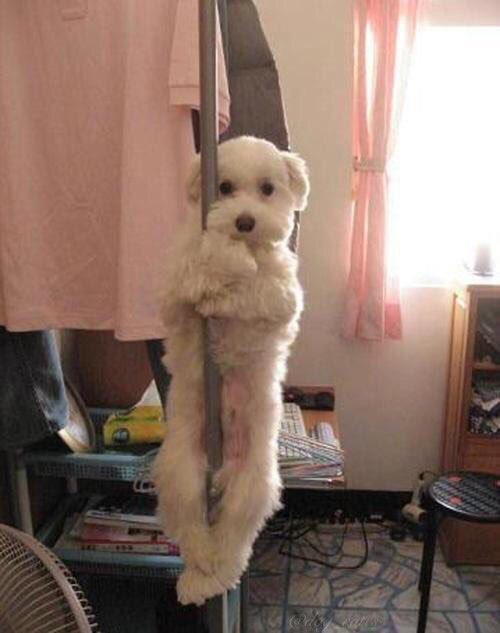

In [89]:
crystal2

In [90]:
master_df.query('rating_numerator ==  2 & name == "Crystal"')

,tweet_id,timestamp,text,expanded_urls,rating_numerator,rating_denominator,name,dog_stage,jpg_url,img_num,p1,p1_conf,p1_dog,retweet_count,favorite_count
1081,678424312106393600,2015-12-20 03:58:55,This is Crystal. She's a shitty fireman. No sense of urgency. People could be dying Crystal. 2/10 just irresponsible https://t.co/rtMtjSl9pz,https://twitter.com/dog_rates/status/678424312106393600/photo/1,2.0,10,Crystal,NaN,https://pbs.twimg.com/media/CWo_T8gW4AAgJNo.jpg,1,maltese_dog,0.759945,True,2276,4996


In [92]:
#top 10 best rated breed on average
master_df.groupby('p1')['rating_numerator'].mean().sort_values(ascending=False)

p1
saluki                            12.500000
briard                            12.333333
tibetan_mastiff                   12.250000
border_terrier                    12.142857
giant_schnauzer                   12.000000
standard_schnauzer                12.000000
silky_terrier                     12.000000
eskimo_dog                        11.777778
gordon_setter                     11.750000
irish_setter                      11.750000
samoyed                           11.743590
appenzeller                       11.666667
golden_retriever                  11.625926
chow                              11.609756
cardigan                          11.529412
australian_terrier                11.500000
wire_haired_fox_terrier           11.500000
great_pyrenees                    11.461538
kelpie                            11.454545
pembroke                          11.443182
norfolk_terrier                   11.428571
leonberg                          11.333333
irish_water_spaniel          

In [93]:
#Top 10 most favourited breed on average
master_df.groupby('p1')['favorite_count'].mean().sort_values(ascending=False)

p1
saluki                            20774.750000
french_bulldog                    16327.920000
afghan_hound                      14694.666667
black_and_tan_coonhound           14653.500000
flat_coated_retriever             14499.000000
irish_water_spaniel               13955.666667
standard_poodle                   13605.142857
english_springer                  13432.777778
cardigan                          13033.235294
leonberg                          12635.000000
eskimo_dog                        12604.444444
basset                            11897.769231
lakeland_terrier                  11673.625000
border_terrier                    11657.857143
great_pyrenees                    11513.461538
samoyed                           11470.435897
bedlington_terrier                11139.800000
mexican_hairless                  10811.500000
golden_retriever                  10609.644444
giant_schnauzer                   10501.333333
norwegian_elkhound                10491.142857
tibetan_ma

In [95]:
#Ranking of dog_stage, to the most favorited to the least
master_df.groupby('dog_stage')['favorite_count'].sum().sort_values(ascending=False)

dog_stage
pupper           997722
doggo            891749
puppo            386774
doggo/pupper     100714
floofer           78454
doggo/puppo       41859
doggo/floofer     14827
Name: favorite_count, dtype: int64

In [96]:
#Let's find out who is the top 1 pupper with the most favorite count
master_df.query('dog_stage == "pupper"').sort_values(by='favorite_count', ascending=False).head(1)


,tweet_id,timestamp,text,expanded_urls,rating_numerator,rating_denominator,name,dog_stage,jpg_url,img_num,p1,p1_conf,p1_dog,retweet_count,favorite_count
97,866450705531457537,2017-05-22 00:28:40,"This is Jamesy. He gives a kiss to every other pupper he sees on his walk. 13/10 such passion, much tender https://t.co/wk7TfysWHr","https://twitter.com/dog_rates/status/866450705531457537/photo/1,https://twitter.com/dog_rates/status/866450705531457537/photo/1",13.0,10,Jamesy,pupper,https://pbs.twimg.com/media/DAZAUfBXcAAG_Nn.jpg,2,french_bulldog,0.905334,True,30145,108787


In [97]:
#Let's print his picture
pupper_url = master_df.loc[97]['jpg_url']

In [98]:
pupper_url

'https://pbs.twimg.com/media/DAZAUfBXcAAG_Nn.jpg'

In [99]:
r_pupper = requests.get(pupper_url)
pupper = Image.open(BytesIO(r_pupper.content))

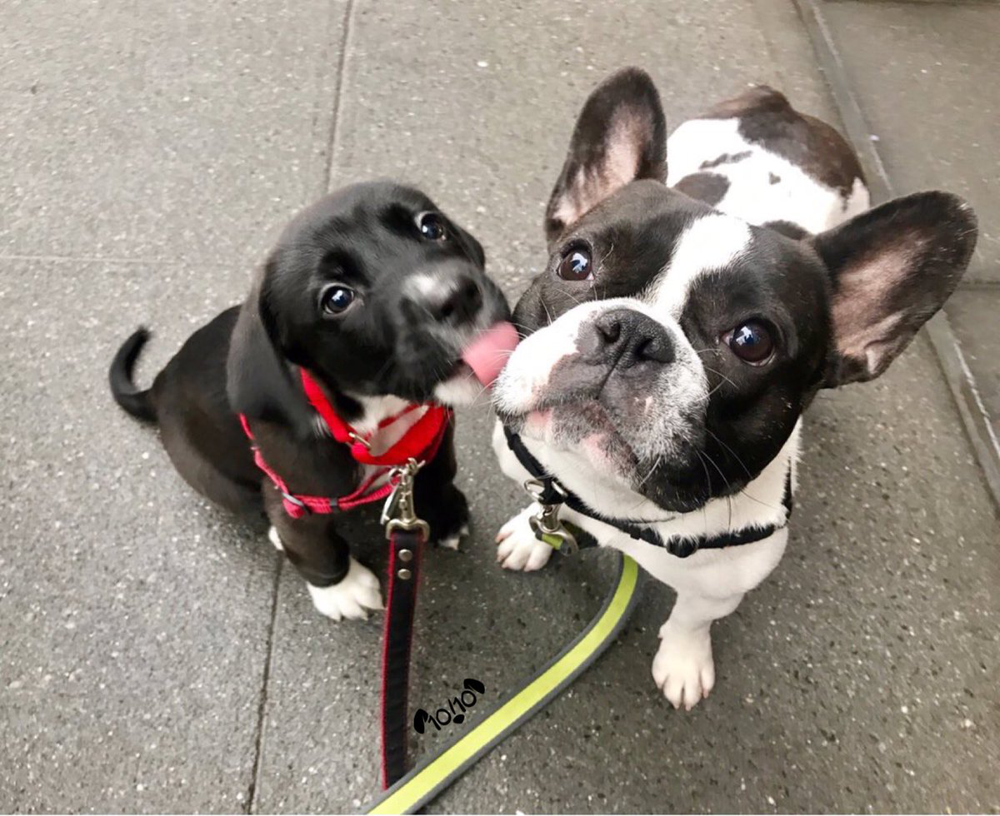

In [100]:
pupper

### Insights:
1. The lowest rated dog is a Maltese named Crystal, with only a 2/10 rating. Justice for Crystal!

2. The dog breed with the best rating on average is also the dog breed with the largest favorite count on average: saluki.

3. Pupper is the dog stage with the highest favorite count

### Visualization

Do the WeRateDogs ratings have an influence on the number of 'favorite' a tweet is going to get? The higher the rating the larger the favorite count?

In [102]:
import matplotlib.pyplot as plt
%matplotlib inline

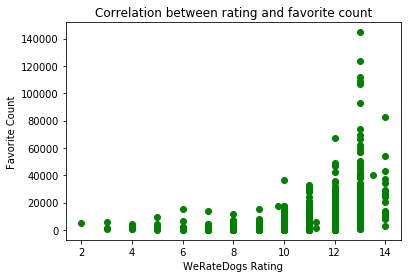

In [103]:
plt.scatter(x=master_df['rating_numerator'], y=master_df['favorite_count'], color='green')
plt.xlabel('WeRateDogs Rating')
plt.ylabel('Favorite Count')
plt.title('Correlation between rating and favorite count');

It looks like the rating from WeRateDogs does have a positive correlation with the number of favorite a tweet is going to get.